In [1]:
import numpy as np 
import pandas as pd 

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))
import warnings
warnings.simplefilter('ignore')
# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/india-headlines-news-dataset/india-news-headlines.csv


In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
print (pd.__version__)

from subprocess import check_output
print(check_output(["ls", "../input"]).decode("utf8"))

df = pd.read_csv("/kaggle/input/india-headlines-news-dataset/india-news-headlines.csv", dtype={'publish_date': object})

df['publish_month'] = df.publish_date.str[:6]
df['publish_year'] = df.publish_date.str[:4]
df['publish_month_only'] = df.publish_date.str[4:6]
df['publish_day_only'] = df.publish_date.str[6:8]

df['dt_date'] = pd.to_datetime(df['publish_date'], format='%Y%m%d')
df['dt_month'] = pd.to_datetime(df['publish_month'], format='%Y%m')

print (df.info())

2.0.3

india-headlines-news-dataset



<class 'pandas.core.frame.DataFrame'>

RangeIndex: 3876557 entries, 0 to 3876556

Data columns (total 9 columns):

 #   Column              Dtype         

---  ------              -----         

 0   publish_date        object        

 1   headline_category   object        

 2   headline_text       object        

 3   publish_month       object        

 4   publish_year        object        

 5   publish_month_only  object        

 6   publish_day_only    object        

 7   dt_date             datetime64[ns]

 8   dt_month            datetime64[ns]

dtypes: datetime64[ns](2), object(7)

memory usage: 266.2+ MB

None


In [3]:
df.head()

,publish_date,headline_category,headline_text,publish_month,publish_year,publish_month_only,publish_day_only,dt_date,dt_month
0,20010102,unknown,Status quo will not be disturbed at Ayodhya; s...,200101,2001,01,02,2001-01-02,2001-01-01
1,20010102,unknown,Fissures in Hurriyat over Pak visit,200101,2001,01,02,2001-01-02,2001-01-01
2,20010102,unknown,America's unwanted heading for India?,200101,2001,01,02,2001-01-02,2001-01-01
3,20010102,unknown,For bigwigs; it is destination Goa,200101,2001,01,02,2001-01-02,2001-01-01
4,20010102,unknown,Extra buses to clear tourist traffic,200101,2001,01,02,2001-01-02,2001-01-01


In [4]:
df.describe(include='all')

,publish_date,headline_category,headline_text,publish_month,publish_year,publish_month_only,publish_day_only,dt_date,dt_month
count,3876557,3876557,3876557,3876557,3876557,3876557,3876557,3876557,3876557
unique,8170,1024,3604755,270,23,12,31,NaN,NaN
top,20141010,india,Straight Answers,201605,2016,05,22,NaN,NaN
freq,706,307371,6723,21698,255910,333880,128443,NaN,NaN
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2014-03-01 10:55:27.614066176,2014-02-14 17:07:22.869173760
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2001-01-02 00:00:00,2001-01-01 00:00:00
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2010-08-27 00:00:00,2010-08-01 00:00:00
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2014-08-08 00:00:00,2014-08-01 00:00:00
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2018-05-28 00:00:00,2018-05-01 00:00:00
max,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2023-06-30 00:00:00,2023-06-01 00:00:00


# Extracting the headlines for the year 2023

In [5]:
df['publish_year'] = pd.to_numeric(df['publish_year'], errors='coerce')
df_2023 = df[df['publish_year'] == 2023]
df_2023.info()

<class 'pandas.core.frame.DataFrame'>

Index: 90076 entries, 3786481 to 3876556

Data columns (total 9 columns):

 #   Column              Non-Null Count  Dtype         

---  ------              --------------  -----         

 0   publish_date        90076 non-null  object        

 1   headline_category   90076 non-null  object        

 2   headline_text       90076 non-null  object        

 3   publish_month       90076 non-null  object        

 4   publish_year        90076 non-null  int64         

 5   publish_month_only  90076 non-null  object        

 6   publish_day_only    90076 non-null  object        

 7   dt_date             90076 non-null  datetime64[ns]

 8   dt_month            90076 non-null  datetime64[ns]

dtypes: datetime64[ns](2), int64(1), object(6)

memory usage: 6.9+ MB


# WordClouds-  Unigrams, Bigrams, trigrams and ngrams

In [6]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords


In [7]:
all_headlines = ' '.join(df_2023['headline_text'].dropna())

In [8]:
words = word_tokenize(all_headlines)

In [9]:
stop_words = set(stopwords.words('english'))
filtered_words = [word.lower() for word in words if word.isalpha() and word.lower() not in stop_words]

In [10]:
word_freq = pd.Series(filtered_words).value_counts()

In [11]:
wordcloud = WordCloud(width=1000, height=600, background_color='white').generate_from_frequencies(word_freq)

In [ ]:
plt.figure(figsize=(24, 12))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

In [13]:
from nltk import bigrams
bigrams_list = list(bigrams(filtered_words))

In [14]:
bigram_strings = [' '.join(bigram) for bigram in bigrams_list]
bigram_freq = pd.Series(bigram_strings).value_counts()

In [15]:
bigram_wordcloud = WordCloud(width=1000, height=600, background_color='white').generate_from_frequencies(bigram_freq)

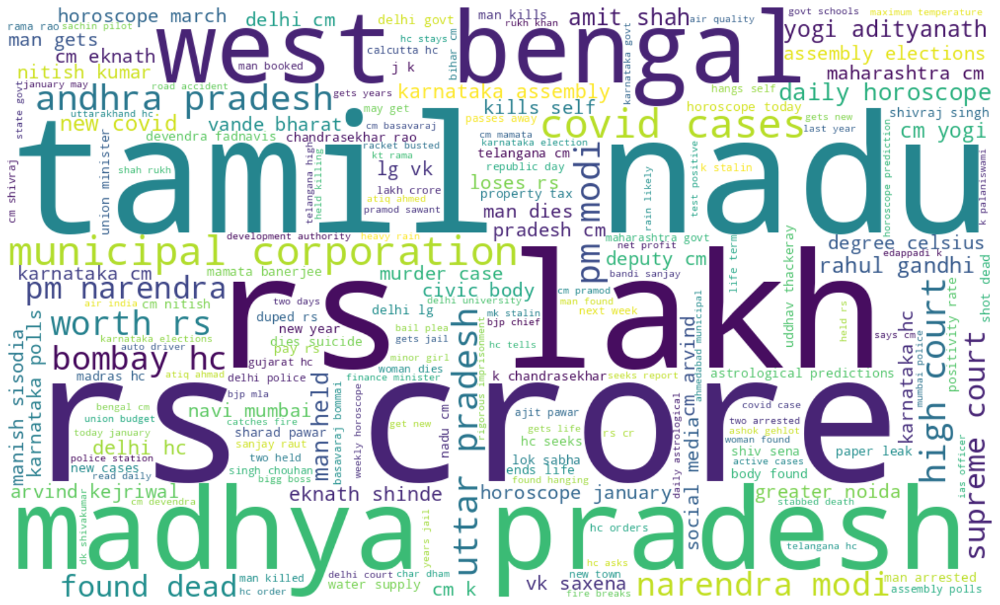

In [16]:
plt.figure(figsize=(24, 12))
plt.imshow(bigram_wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

In [17]:
from nltk import ngrams

trigrams_list = list(ngrams(filtered_words, 3))

trigram_strings = [' '.join(trigram) for trigram in trigrams_list]

trigram_freq = pd.Series(trigram_strings).value_counts()

trigram_wordcloud = WordCloud(width=1000, height=600, background_color='white').generate_from_frequencies(trigram_freq)


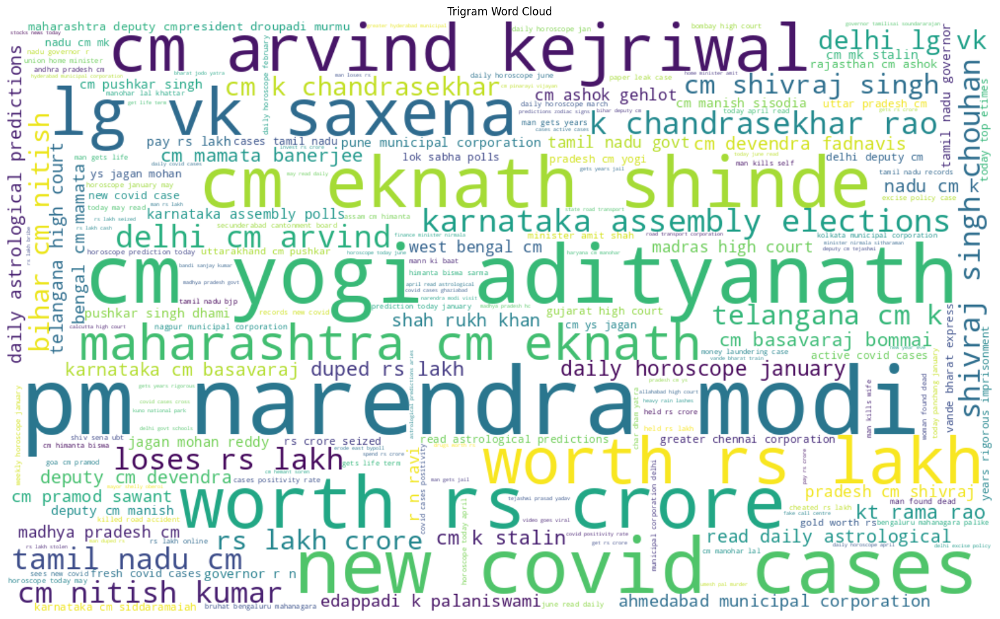

In [18]:
plt.figure(figsize=(24, 12))
plt.imshow(trigram_wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Trigram Word Cloud')
plt.show()

In [19]:

quadgrams_list = list(ngrams(filtered_words, 4))

quadgram_strings = [' '.join(quadgram) for quadgram in quadgrams_list]

quadgram_freq = pd.Series(quadgram_strings).value_counts()

quadgram_wordcloud = WordCloud(width=1000, height=600, background_color='white').generate_from_frequencies(quadgram_freq)


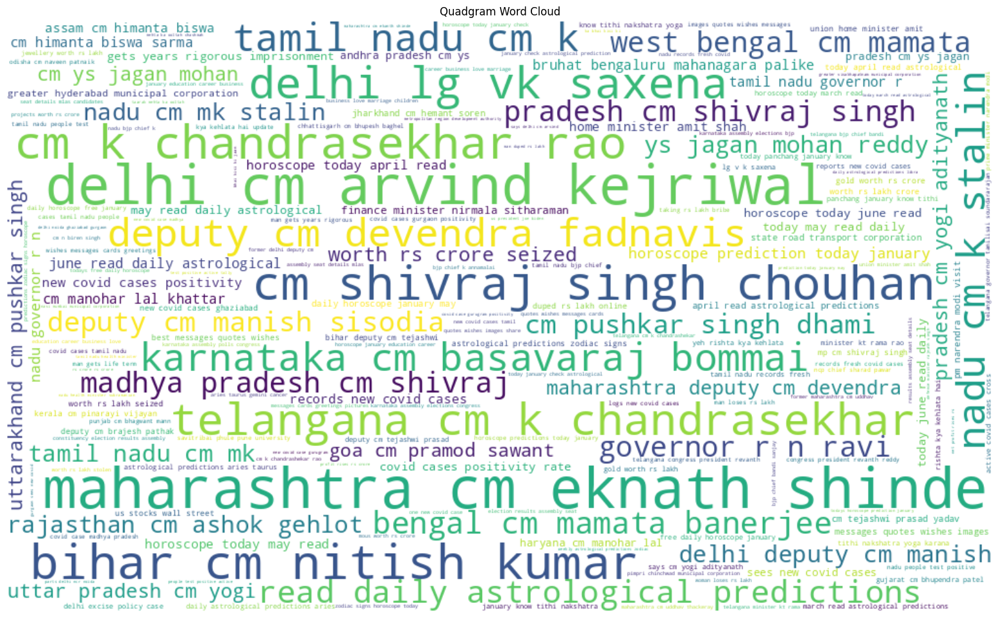

In [20]:
plt.figure(figsize=(24, 12))
plt.imshow(quadgram_wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Quadgram Word Cloud')
plt.show()

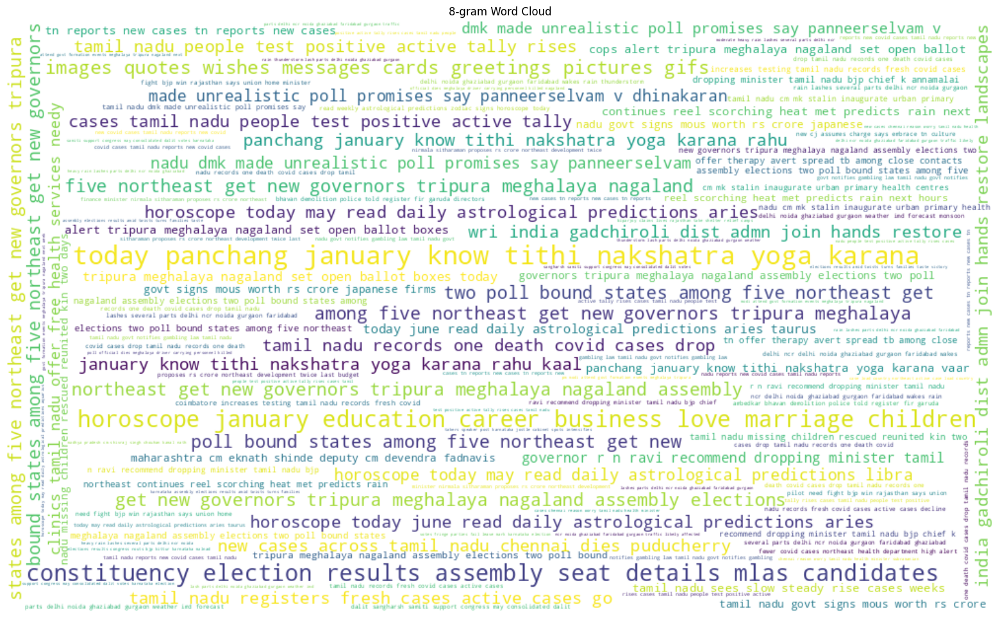

In [21]:
num_words = 8 #change the no of words here  
ngrams_list = list(ngrams(filtered_words, num_words))
ngram_strings = [' '.join(ngram) for ngram in ngrams_list]
ngram_freq = pd.Series(ngram_strings).value_counts()


ngram_wordcloud = WordCloud(width=1000, height=600, background_color='white').generate_from_frequencies(ngram_freq)

plt.figure(figsize=(24, 12))
plt.imshow(ngram_wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title(f'{num_words}-gram Word Cloud')
plt.show()


# Sentiment Analysis

In [22]:
from nltk.sentiment.vader import SentimentIntensityAnalyzer

In [23]:
sia = SentimentIntensityAnalyzer()
df_2023.loc[:, 'compound'] = df_2023['headline_text'].apply(lambda x: sia.polarity_scores(x)['compound'])

In [24]:
df_2023['sentiment'] = df_2023['compound'].apply(lambda x: 'positive' if x >= 0 else 'negative')

In [ ]:
df_2023[['headline_text', 'compound', 'sentiment']]

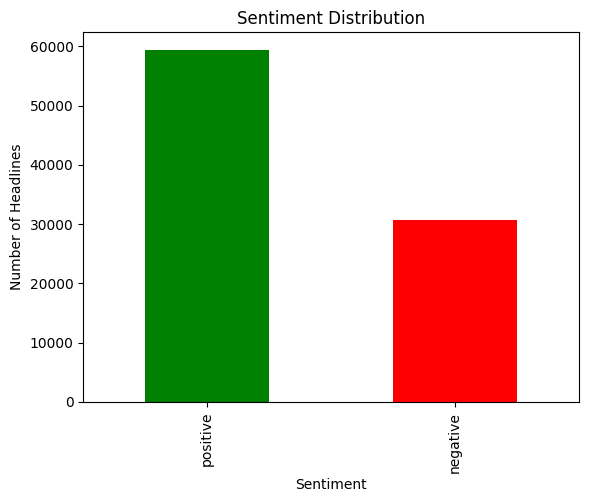

In [26]:
sentiment_distribution = df_2023['sentiment'].value_counts()
sentiment_distribution.plot(kind='bar', color=['green', 'red'])
plt.title('Sentiment Distribution')
plt.xlabel('Sentiment')
plt.ylabel('Number of Headlines')
plt.show()

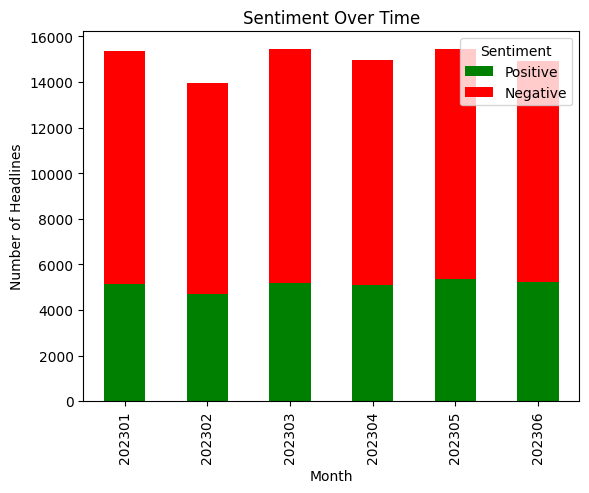

In [27]:
monthly_sentiment = df_2023.groupby('publish_month')['sentiment'].value_counts().unstack().fillna(0)
monthly_sentiment.plot(kind='bar', stacked=True, color=['green', 'red'])
plt.title('Sentiment Over Time')
plt.xlabel('Month')
plt.ylabel('Number of Headlines')
plt.legend(title='Sentiment', loc='upper right', labels=['Positive', 'Negative'])
plt.show()

In [ ]:
top_positive_headlines = df_2023[df_2023['sentiment'] == 'positive'].nlargest(5, 'compound')[['headline_text', 'compound']]
top_negative_headlines = df_2023[df_2023['sentiment'] == 'negative'].nsmallest(5, 'compound')[['headline_text', 'compound']]
print("Top Positive Headlines:")
print(top_positive_headlines)
print("\nTop Negative Headlines:")
print(top_negative_headlines)

In [29]:
positive_words = ' '.join(df_2023[df_2023['sentiment'] == 'positive']['headline_text'])
negative_words = ' '.join(df_2023[df_2023['sentiment'] == 'negative']['headline_text'])

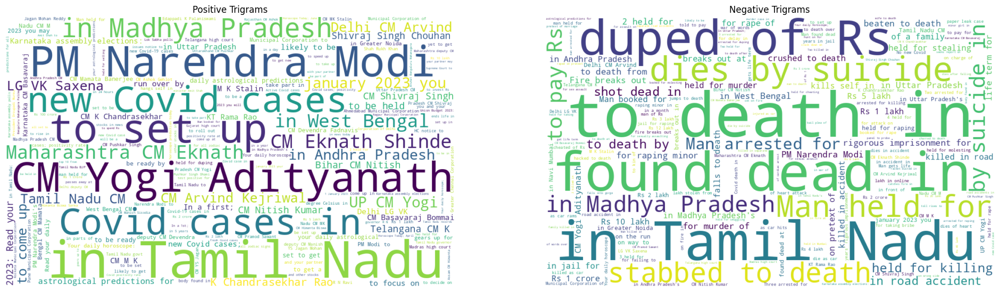

In [30]:
positive_trigrams_list = list(ngrams(positive_words.split(), 3))
negative_trigrams_list = list(ngrams(negative_words.split(), 3))

positive_trigram_strings = [' '.join(trigram) for trigram in positive_trigrams_list]
negative_trigram_strings = [' '.join(trigram) for trigram in negative_trigrams_list]

positive_trigram_freq = pd.Series(positive_trigram_strings).value_counts()
negative_trigram_freq = pd.Series(negative_trigram_strings).value_counts()


positive_trigram_wordcloud = WordCloud(width=1000, height=600, background_color='white').generate_from_frequencies(positive_trigram_freq)
negative_trigram_wordcloud = WordCloud(width=1000, height=600, background_color='white').generate_from_frequencies(negative_trigram_freq)

plt.figure(figsize=(24, 12))
plt.subplot(1, 2, 1)
plt.imshow(positive_trigram_wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Positive Trigrams')

plt.subplot(1, 2, 2)
plt.imshow(negative_trigram_wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Negative Trigrams')

plt.show()

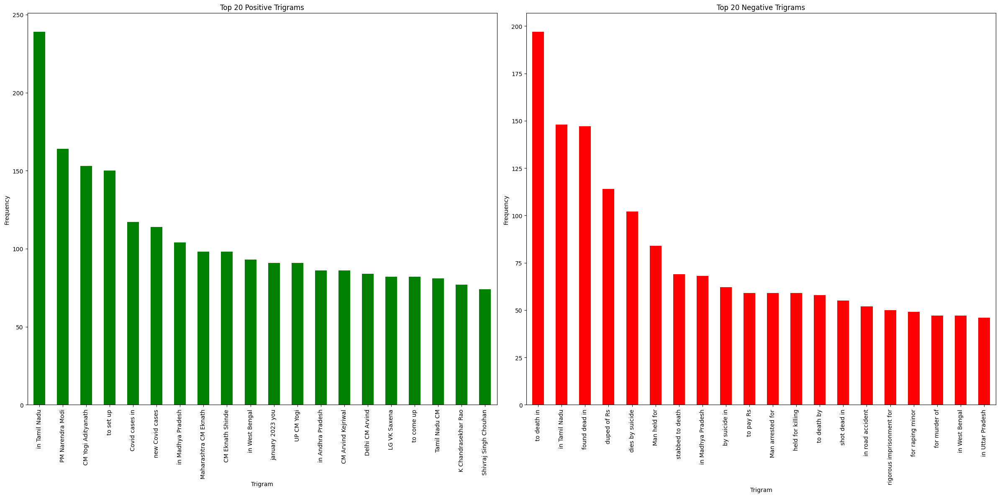

In [31]:
plt.figure(figsize=(24, 12))

plt.subplot(1, 2, 1)
positive_trigram_freq.head(20).plot(kind='bar', color='green')
plt.title('Top 20 Positive Trigrams')
plt.xlabel('Trigram')
plt.ylabel('Frequency')

plt.subplot(1, 2, 2)
negative_trigram_freq.head(20).plot(kind='bar', color='red')
plt.title('Top 20 Negative Trigrams')
plt.xlabel('Trigram')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

# Topic Modelling

In [32]:
from sklearn.feature_extraction.text import CountVectorizer
from nltk.corpus import stopwords

corpus = df_2023['headline_text']

stop_words = 'english'
vectorizer = CountVectorizer(stop_words=stop_words, token_pattern=r'\b\w+\b')
X = vectorizer.fit_transform(corpus)


In [33]:
from sklearn.decomposition import LatentDirichletAllocation
num_topics = 20
lda_model = LatentDirichletAllocation(n_components=num_topics, random_state=42)
lda_model.fit(X)


LatentDirichletAllocation(n_components=20, random_state=42)

In [34]:
feature_names = vectorizer.get_feature_names_out()
num_top_words = 10  
topics = {}

for topic_idx, topic in enumerate(lda_model.components_):
    top_words_idx = topic.argsort()[:-num_top_words - 1:-1]
    top_words = [feature_names[i] for i in top_words_idx]
    topics[f"Topic {topic_idx + 1}"] = top_words

df_topics = pd.DataFrame(topics)
df_topics

,Topic 1,Topic 2,Topic 3,Topic 4,Topic 5,Topic 6,Topic 7,Topic 8,Topic 9,Topic 10,Topic 11,Topic 12,Topic 13,Topic 14,Topic 15,Topic 16,Topic 17,Topic 18,Topic 19,Topic 20
0,year,cm,students,pradesh,new,s,covid,2023,hc,state,killed,k,tamil,s,ahead,s,bjp,s,rs,s
1,old,govt,bengal,madhya,tax,bihar,cases,today,court,govt,dies,paper,nadu,delhi,monsoon,pm,karnataka,budget,held,case
2,man,minister,schools,andhra,road,corporation,1,horoscope,govt,staff,cops,leak,s,woman,final,modi,congress,adani,crore,murder
3,s,says,west,uttar,soon,municipal,new,likely,high,security,2,fadnavis,waste,hospital,mumbai,cm,s,water,lakh,accused
4,girl,t,school,s,city,body,2,march,sc,iit,car,reddy,m,kolkata,ukraine,metro,polls,india,2,probe
5,death,new,health,years,work,delhi,3,january,delhi,save,road,telangana,stalin,food,t,telangana,says,forest,arrested,bail
6,yr,delhi,class,china,green,kumar,years,rain,order,team,man,j,social,water,s,maharashtra,assembly,supply,man,court
7,woman,karnataka,exam,gets,parking,cm,000,days,shah,meghalaya,injured,devendra,e,residents,chennai,narendra,cong,day,1,cbi
8,minor,yogi,govt,indian,safety,civic,19,daily,bombay,service,dead,maharashtra,india,day,senior,rao,poll,lake,3,ed
9,held,adityanath,board,singh,traffic,nitish,5,day,seeks,assam,bus,east,governor,dog,state,shinde,elections,away,5,delhi


In [35]:
df_2023.loc[:, 'topic'] = lda_model.transform(X).argmax(axis=1) + 1

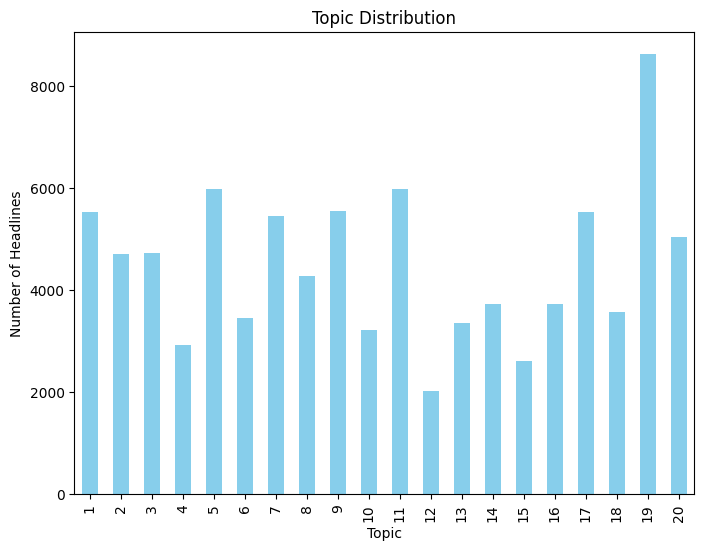

In [36]:
topic_distribution = df_2023['topic'].value_counts().sort_index()
plt.figure(figsize=(8, 6))
topic_distribution.plot(kind='bar', color='skyblue')
plt.title('Topic Distribution')
plt.xlabel('Topic')
plt.ylabel('Number of Headlines')
plt.show()

In [37]:
topic_19_headlines = df_2023[df_2023['topic'] == 19]['headline_text']
topic_19_corpus = topic_19_headlines.values
vectorizer_topic_19 = CountVectorizer(stop_words='english', token_pattern=r'\b\w+\b')
X_topic_19 = vectorizer_topic_19.fit_transform(topic_19_corpus)

feature_names_topic_19 = vectorizer_topic_19.get_feature_names_out()
top_words_topic_19 = pd.Series(X_topic_19.sum(axis=0).A1, index=feature_names_topic_19)
top_words_topic_19 = top_words_topic_19.sort_values(ascending=False)
top_words_topic_19.head(20)


rs          2835
held        1860
lakh        1351
crore       1287
2           1106
man          905
s            827
arrested     775
1            758
3            696
5            595
mumbai       586
000          562
woman        495
4            494
worth        462
cops         406
police       401
delhi        364
fraud        351
dtype: int64

In [38]:
for topic_num in range(1, num_topics + 1):
    print(f"Topic {topic_num}:")
    print(df_2023[df_2023['topic'] == topic_num]['headline_text'].head(10))
    print("\n")

Topic 1:

3786513                     Ushering in a year of wellness !

3786516                     Ushering in a year of wellness !

3786528    I can't imagine anyone but Sohel as Lucky Laks...

3786537    Man-animal conflict claims another life; 2022 ...

3786539    22-year-old held for killing wife; friend over...

3786564                            Man dies in self accident

3786607       Mumbai turns into party zone on New Year's Eve

3786612    Doctor gets 10-year jail for raping colleague ...

3786618    8-year-old boy abused by seniors in south Delh...

3786633    19-year-old girl stabbed to death at home by y...

Name: headline_text, dtype: object





Topic 2:

3786546    Government's duty to hone students' talents by...

3786559    Goa police set up centralised monitoring syste...

3786579    New Year gift for Delhi: Licensing norms for r...

3786646    In Kolkata; some bring party home with DJ & ca...

3786651    Haridwar-based Gurukul Kangri University VC re...

3786677   

In [39]:
df_2023

,publish_date,headline_category,headline_text,publish_month,publish_year,publish_month_only,publish_day_only,dt_date,dt_month,compound,sentiment,topic
3786481,20230101,life-style.events,happy new year 2023 memes messages wishes 10 f...,202301,2023,01,01,2023-01-01,2023-01-01,0.8957,positive,18
3786482,20230101,life-style.events,happy new year quotes wishes and messages to s...,202301,2023,01,01,2023-01-01,2023-01-01,0.8625,positive,18
3786483,20230101,astrology.horoscope,Today's Panchang; 1 January 2023: Auspicious T...,202301,2023,01,01,2023-01-01,2023-01-01,0.2023,positive,3
3786484,20230101,astrology.panchang,Today's Panchang; 1 January 2023: Auspicious T...,202301,2023,01,01,2023-01-01,2023-01-01,0.2023,positive,3
3786485,20230101,astrology.horoscope,Aries Today's Rashifal - 1 January 2023: Your ...,202301,2023,01,01,2023-01-01,2023-01-01,0.5719,positive,8
...,...,...,...,...,...,...,...,...,...,...,...,...
3876552,20230630,city.goa,10 PIs move HC over thwarted seniority,202306,2023,06,30,2023-06-30,2023-06-01,-0.0258,negative,13
3876553,20230630,city.goa,Govt notifies award in memory of Parrikar for ...,202306,2023,06,30,2023-06-30,2023-06-01,0.5423,positive,13
3876554,20230630,city.goa,After youth's death; PWD installs crash barrie...,202306,2023,06,30,2023-06-30,2023-06-01,-0.7650,negative,11
3876555,20230630,city.goa,Authorities not acting against CRZ violations,202306,2023,06,30,2023-06-30,2023-06-01,-0.5267,negative,13


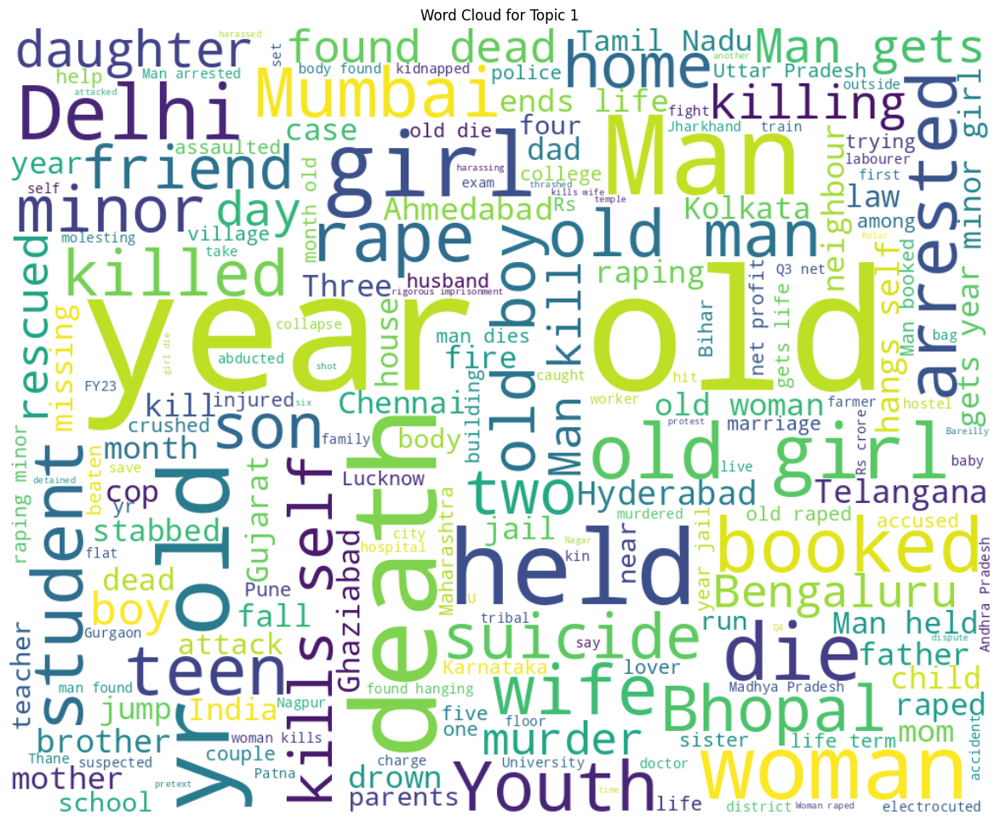

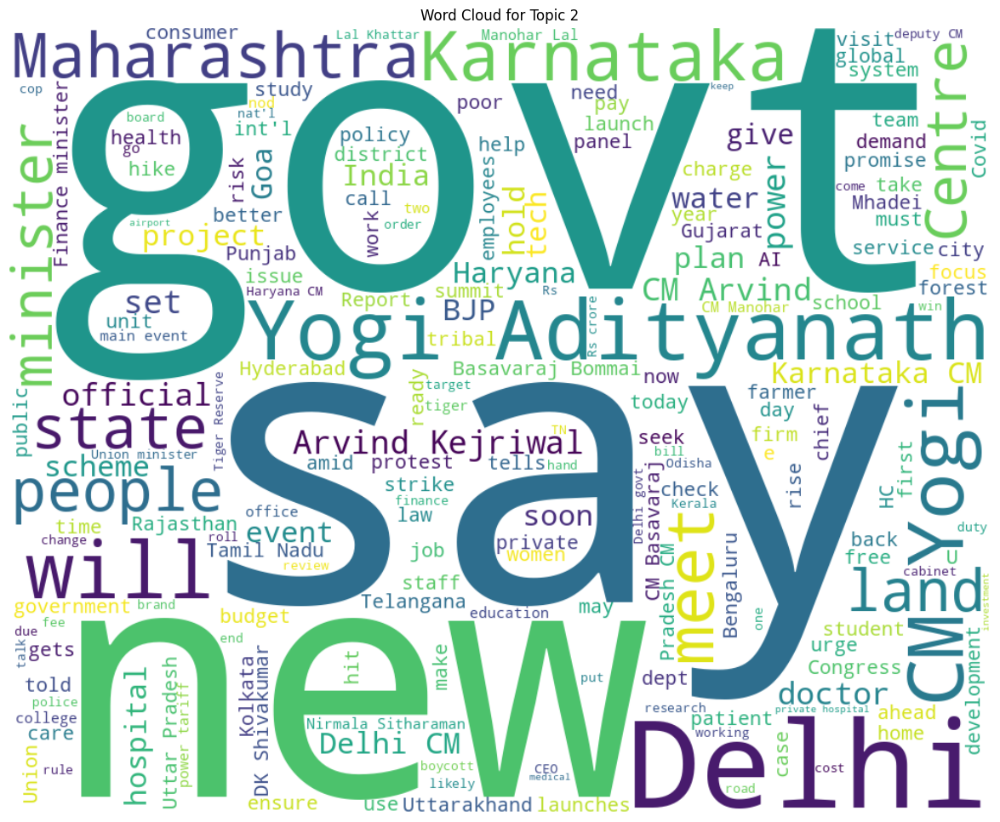

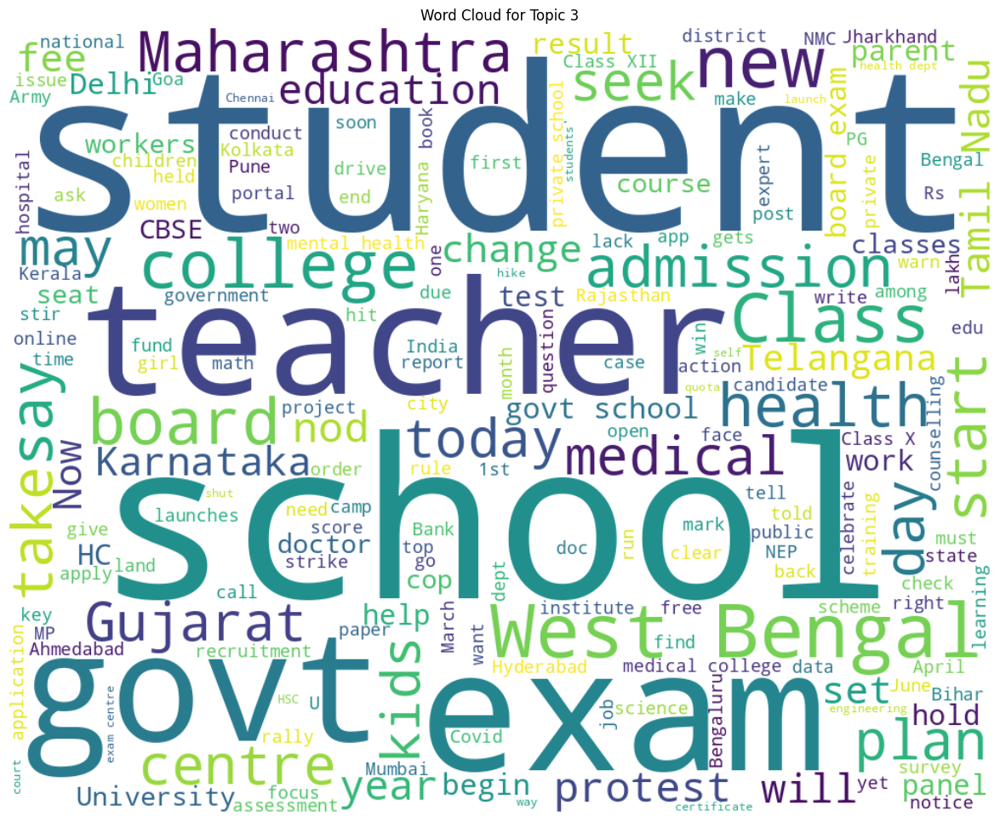

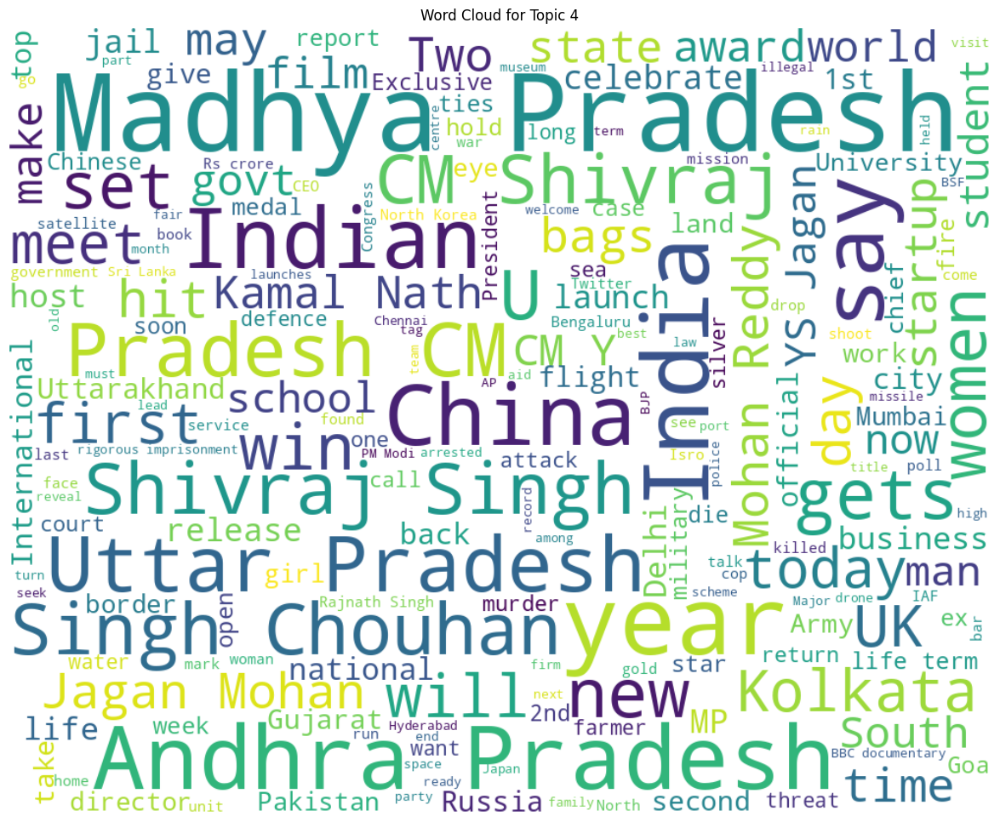

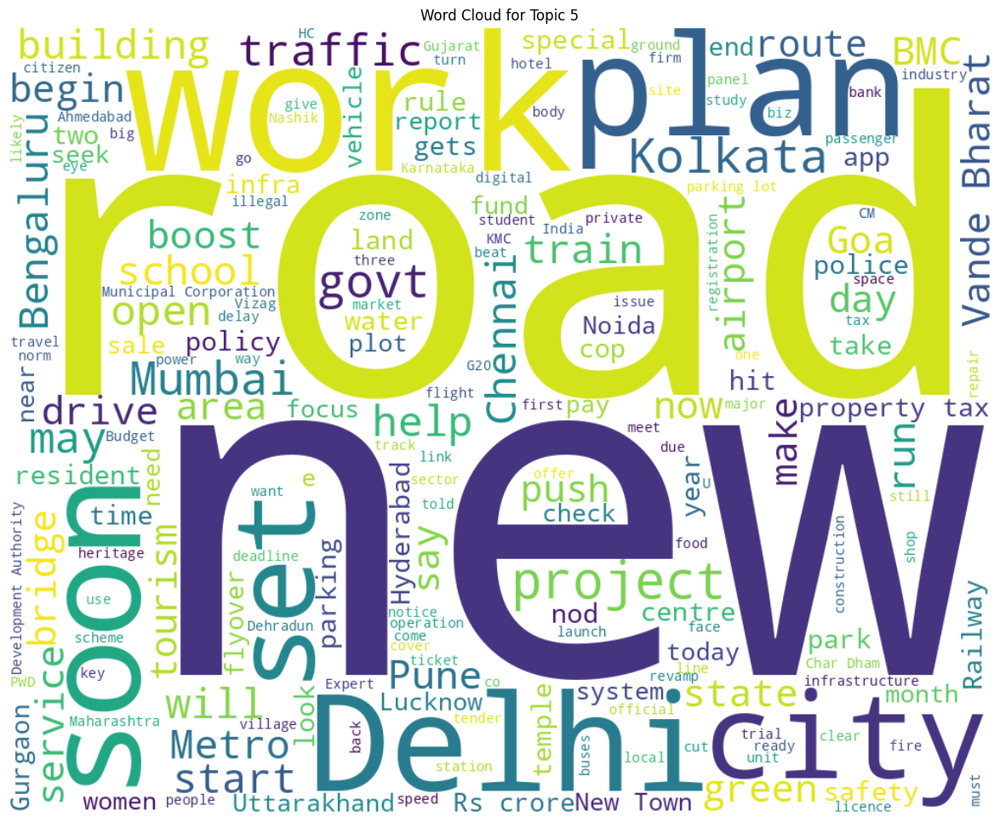

...

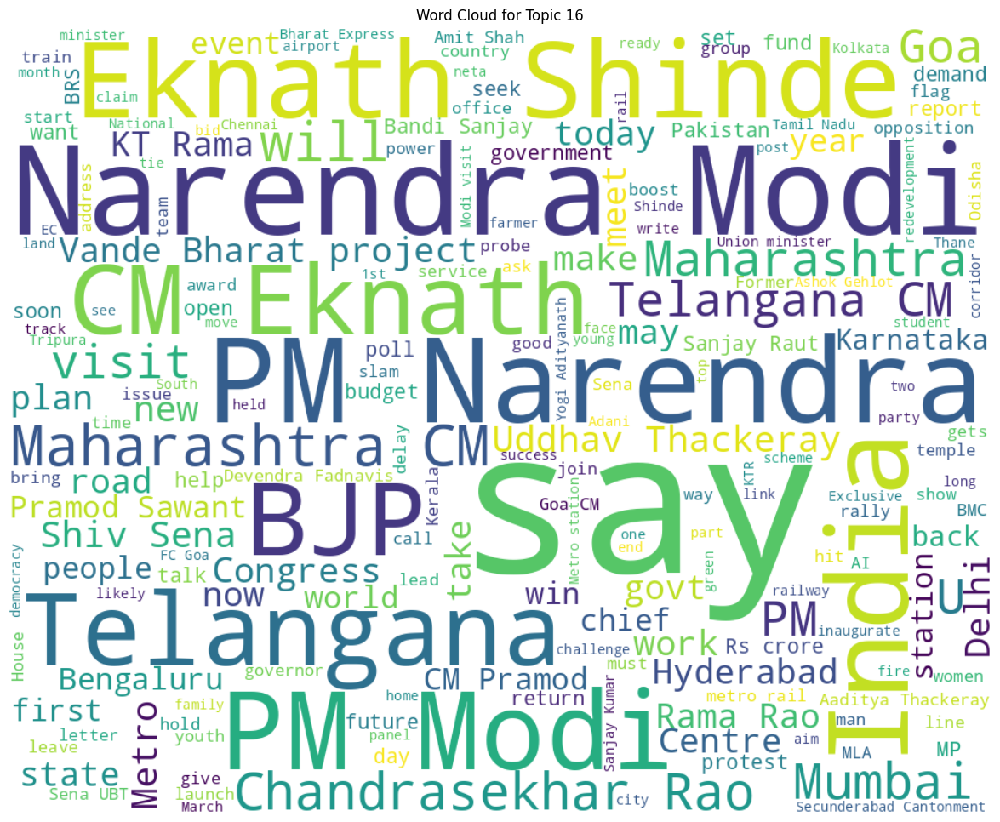

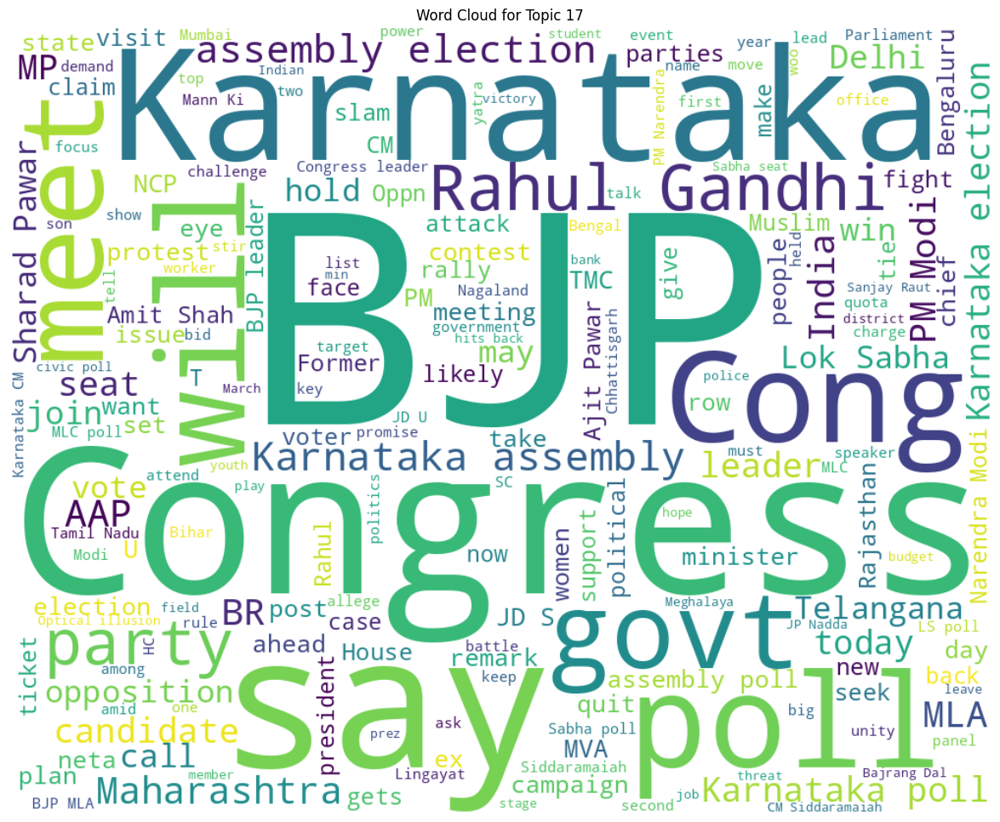

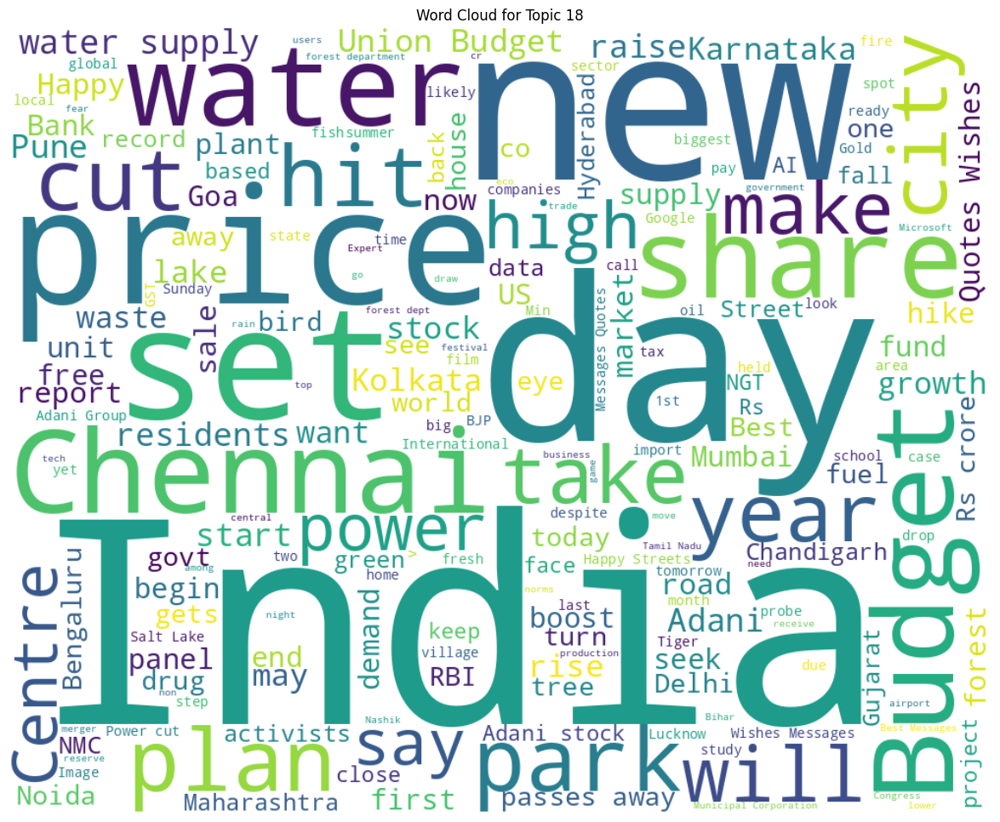

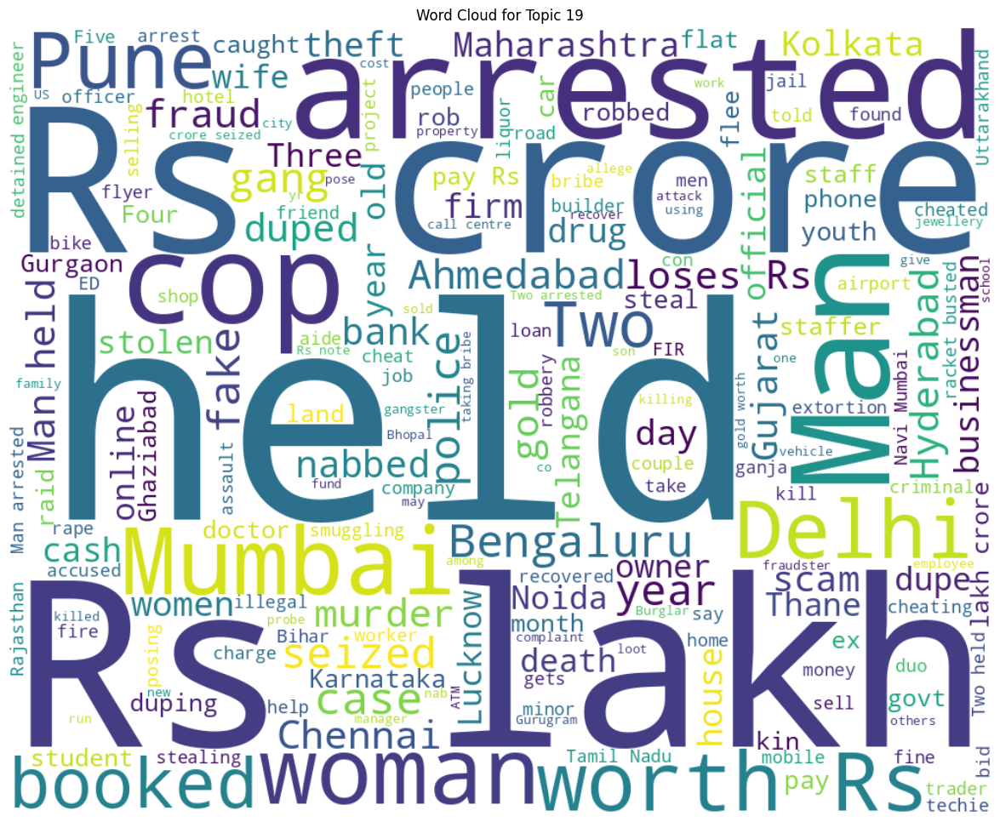

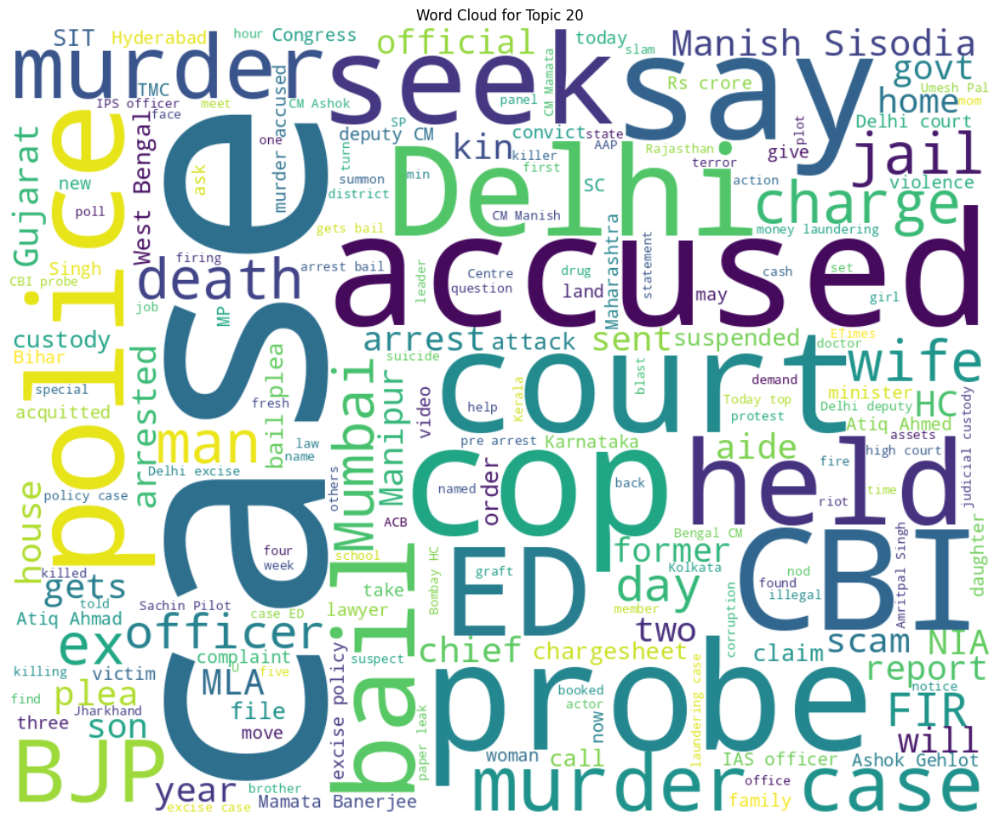

In [40]:
num_topics = df_2023['topic'].nunique()
for topic_num in range(1, num_topics + 1):
    topic_headlines = df_2023[df_2023['topic'] == topic_num]['headline_text']
    text_for_wordcloud = ' '.join(topic_headlines)
    
    wordcloud = WordCloud(width=1000, height=800, background_color='white').generate(text_for_wordcloud)
    
    plt.figure(figsize=(24, 12))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(f'Word Cloud for Topic {topic_num}')
    plt.show()

# Named Entity Recognition (NER)

In [41]:
import nltk
from nltk import word_tokenize, pos_tag, ne_chunk
nltk.download('maxent_ne_chunker')
nltk.download('words')

[nltk_data] Downloading package maxent_ne_chunker to

[nltk_data]     /usr/share/nltk_data...

[nltk_data]   Package maxent_ne_chunker is already up-to-date!

[nltk_data] Downloading package words to /usr/share/nltk_data...

[nltk_data]   Package words is already up-to-date!


True

In [42]:
for i in range(5):
    sample_headline = df_2023['headline_text'].iloc[i]

    words = word_tokenize(sample_headline)
    tags = pos_tag(words)
    tree = ne_chunk(tags)

    entities = []
    for subtree in tree:
        if isinstance(subtree, nltk.Tree):
            entity = " ".join([token[0] for token in subtree.leaves()])
            entities.append(entity)

    print(f"Named Entities in Headline {i + 1}:")
    print(entities)
    print("\n" + "-"*50 + "\n")


Named Entities in Headline 1:

[]



--------------------------------------------------



Named Entities in Headline 2:

[]



--------------------------------------------------



Named Entities in Headline 3:

['Panchang', 'Important']



--------------------------------------------------



Named Entities in Headline 4:

['Panchang', 'Important']



--------------------------------------------------



Named Entities in Headline 5:

['Rashifal']



--------------------------------------------------




In [43]:
from collections import Counter

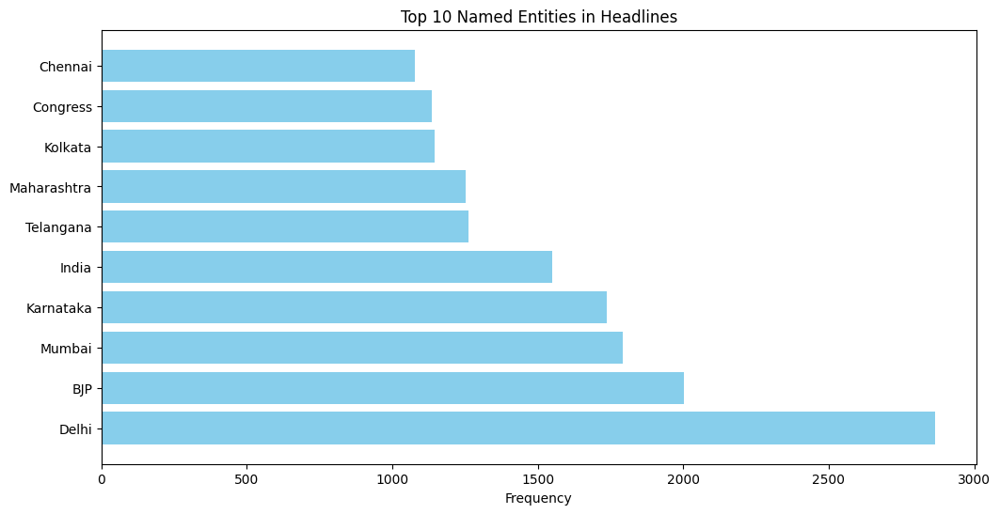

In [44]:
all_entities = []
for headline in df_2023['headline_text']:
    words = word_tokenize(headline)
    tags = pos_tag(words)
    tree = ne_chunk(tags)

    entities = [entity for subtree in tree if isinstance(subtree, nltk.Tree)
                for entity in [" ".join([token[0] for token in subtree.leaves()])]]
    all_entities.extend(entities)

entity_counts = Counter(all_entities)

top_entities = entity_counts.most_common(10)

entities, counts = zip(*top_entities)
plt.figure(figsize=(12, 6))
plt.barh(entities, counts, color='skyblue')
plt.xlabel('Frequency')
plt.title('Top 10 Named Entities in Headlines')
plt.show()

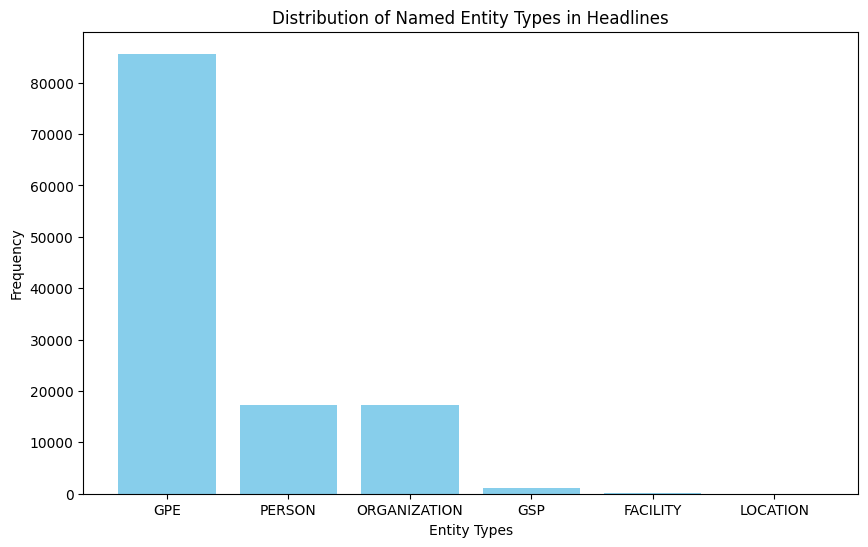

In [46]:
entity_types = [entity[1] if len(entity) > 1 else "Unknown" for entity in entity_counts.keys()]
entity_type_counts = Counter(entity_types)
entity_type_counts = Counter()
for entity in all_entities:
    words = word_tokenize(entity)
    tags = pos_tag(words)
    tree = ne_chunk(tags)
    entity_type = [subtree.label() for subtree in tree if isinstance(subtree, nltk.Tree)]
    if entity_type:
        entity_type_counts[entity_type[0]] += 1

plt.figure(figsize=(10, 6))
plt.bar(entity_type_counts.keys(), entity_type_counts.values(), color='skyblue')
plt.xlabel('Entity Types')
plt.ylabel('Frequency')
plt.title('Distribution of Named Entity Types in Headlines')
plt.show()